# <font color=green>deepBreaks Applications</font>
## Modeling spectral tuning sites of opsin proteins based on amino-acid sequence...  

# <font color=red>Step 0: mySQL DB Setup -</font> Script 0
## *The following text is a script written in mySQL format. You can copy and paste this directly into a mySQL text file or query window within mySQL workbench.*
```
DROP DATABASE vizphiz;
CREATE DATABASE vizphiz;
USE vizphiz;

CREATE TABLE lamdamax
(
id int unsigned not null primary key,
genus varchar(50),
species varchar(50),
celltype varchar(50),
cellsubtype varchar(50),
lamdamax decimal(9,5),
error decimal(9,5),
chromophore varchar(50),
method varchar(50),
stage varchar(50),
refid int,
notes varchar(1000)
);

CREATE TABLE heterologous
(
hetid int unsigned not null primary key,
genus  varchar(50),
species varchar(50),
accession varchar(500),
mutations varchar(500),
lamdamax decimal(9,5),
error decimal(9,5),
cellculture varchar(50),
purification varchar(50),
spectrum varchar(50),
sourcetype varchar(50),
refid int,
notes varchar(1000)
);

CREATE TABLE links
(
linkid int unsigned not null primary key,
accession varchar(500),
maxid int,
refid int,
evidence varchar(1000)
);

CREATE TABLE search
(
searchid int unsigned not null primary key,
researcher varchar(50),
month int,
year int,
engine varchar(500),
keywords varchar(500)
);

CREATE TABLE opsins
(
opsinid int unsigned not null primary key,
genefamily varchar(50),
genenames varchar(50),
genus varchar(50),
phylum varchar(25,)
species varchar(50),
db varchar(50),
accession varchar(500),
dna varchar(10000),
aa varchar(3333),
refid int
);

CREATE TABLE refs
(
refid int,
doilink varchar(100),
searchid int
);
``` 

In [12]:
#All neccessary packages to import for data process steps.
import mysql
import mysql.connector
#install mysql-connector-python // NOT mysql-connector
import re
import os
import datetime 

# <font color=red>STEP 0: Data Base Setup -</font> Script 1 - Import heterologous.tsv into mySQL


In [ ]:
mydb = mysql.connector.connect(
  host="localhost",
  user="root",
  database= "vizphiz",
  password= "Geass5566!!"
)

#read file for data
file1 = open('heterologous.tsv', 'r', encoding="utf8")
Lines = file1.readlines()

count=0
for line in Lines:
    columns = line.split("\t")
    print(columns)
    mycursor = mydb.cursor()

    sql = "INSERT INTO opsins.heterologous (hetid, genus, species, accession, mutations, lamdamax, error, cellculture, purification, spectrum, sourcetype, refid) VALUES (%s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s)"
    val = (columns[0], columns[1], columns[2], columns[3], columns[4], columns[5], columns[6], columns[7], columns[8], columns[9], columns[10], columns[11])
    print(sql)
    print(val)

    mycursor.execute(sql, val)

    mydb.commit()

    print(mycursor.rowcount, "record inserted.")

# <font color=red>STEP 0: Data Base Setup -</font> Script 2 - Import opsindb.tsv into mySQL

In [ ]:
mydb = mysql.connector.connect(
  host="localhost",
  user="root",
  database= "vizphiz",
  password= "Geass5566!!"
)

#read file for data
file1 = open('opsindb.tsv', 'r')
Lines = file1.readlines()

count=0
for line in Lines:
    columns = line.split("\t")

    mycursor = mydb.cursor()

    sql = "INSERT INTO opsins.opsins (opsinid, genefamily, genenames, genus, species, phylum, db, accession, dna, aa, refid) VALUES (%s, %s, %s, %s, %s, %s, %s, %s, %s, %s)"
    val = (columns[0], columns[1], columns[2], columns[3], columns[4], columns[5], columns[6], columns[7], columns[8], columns[9], columns[10])
    print(sql)
    print(val)

    mycursor.execute(sql, val)

    mydb.commit()

    print(mycursor.rowcount, "record inserted.")


# <font color=red>STEP 1: Extract Data From Vizphiz</font>
### Output = 5 different 'versions' // 'splits' of the data. 
### !Take outputs and run through MAFFT before moving on to STEP2!
### Suggested parameters for 'mafft' alignment are...
1. Fasta Format (Sorted)

2. Strategy = FFT-NS-2 // G-INS-1

In [15]:
inv = re.compile('^Rtc|^BRh[0-3]|Pr[A-Z]|Rh1,Rh3|^IV|^inv')
rod = re.compile('Rh[0-2]|exoRh')
d = re.compile("^NM_001014890.2$|^NM_001014890$")
iec = re.compile("Limenitis|Papilio")

In [19]:
#directory preperation
dt_label = datetime.datetime.now().strftime('%Y-%m-%d_%H-%M-%S')
report_dir = str(f'vizphiz_data_splits_{dt_label}')
os.makedirs(report_dir)

wd_output = f'{report_dir}/wds.txt'
sws_output = f'{report_dir}/swd.txt'
mws_output = f'{report_dir}/mwd.txt'
rod_output = f'{report_dir}/rod.txt'
wd_ni_output = f'{report_dir}/wds_ni.txt'
inv_output = f'{report_dir}/inv_only.txt'
nmoc_output = f'{report_dir}/nmoc.txt'
wh_metadata = f'{report_dir}/wds_meta.tsv'
sw_metadata = f'{report_dir}/sws_meta.tsv'
mw_metadata = f'{report_dir}/mws_meta.tsv'
rh_metadata = f'{report_dir}/rod_meta.tsv'
wd_ni_metadata = f'{report_dir}/wds_ni_meta.tsv'
inv_metadata = f'{report_dir}/inv_meta.tsv'
nmoc_metadata = f'{report_dir}/nmoc_meta.tsv'

m = 0
s = 0
l = 0
r = 0
c = 0
z = 0
q = 0

mydb = mysql.connector.connect(
  host="localhost",
  user="root",
  database="vizphiz",
  password="Geass5566!!"
) 
mycursor = mydb.cursor()

sql = "select DISTINCT o.genus,o.species,o.genefamily,o.accession,h.lamdamax,o.aa,o.phylum from opsins.opsins o, opsins.heterologous h WHERE (o.accession = h.accession AND o.refid = h.refid); "
mycursor.execute(sql)
myresult = mycursor.fetchall()


for x in myresult:       
#REG-DATA SECTION    
  with open(wd_output, 'a') as f:
    if m == 0:
      f.write(">Bovine\nMNGTEGPNFYVPFSNKTGVVRSPFEAPQYYLAEPWQFSMLAAYMFLLIMLGFPINFLTLYVTVQHKKLRTPLNYILLNLAVADLFMVFGGFTTTLYTSLHGYFVFGPTGCNLEGFFATLGGEIALWSLVVLAIERYVVVCKPMSNFRFGENHAIMGVAFTWVMALACAAPPLVGWSRYIPEGMQCSCGIDYYTPHEETNNESFVIYMFVVHFIIPLIVIFFCYGQLVFTVKEAAAQQQESATTQKAEKEVTRMVIIMVIAFLICWLPYAGVAFYIFTHQGSDFGPIFMTIPAFFAKTSAVYNPVIYIMMNKQFRNCMVTTLCCGKNPLGDDEASTTVSKTETSQVAPA\n")
    if (d.match(x[3])):
      pass
    else:
      m += 1 
      #This makes the fasta format file
      seq = ">S" + str(m)
      f.write(seq)
      seq2 = str('\n' + x[5] + '\n')
      f.write(seq2)

  with open(wd_ni_output, 'a') as f:
    p = re.compile('^Rtc|^BRh[0-3]|Pr[A-Z]|Rh1,Rh3|^IV|^inv')
    if (p.match(x[2]) or d.match(x[3]) or iec.match(x[0])):
      pass
    else:
      if c == 0:
        f.write(">Bovine\nMNGTEGPNFYVPFSNKTGVVRSPFEAPQYYLAEPWQFSMLAAYMFLLIMLGFPINFLTLYVTVQHKKLRTPLNYILLNLAVADLFMVFGGFTTTLYTSLHGYFVFGPTGCNLEGFFATLGGEIALWSLVVLAIERYVVVCKPMSNFRFGENHAIMGVAFTWVMALACAAPPLVGWSRYIPEGMQCSCGIDYYTPHEETNNESFVIYMFVVHFIIPLIVIFFCYGQLVFTVKEAAAQQQESATTQKAEKEVTRMVIIMVIAFLICWLPYAGVAFYIFTHQGSDFGPIFMTIPAFFAKTSAVYNPVIYIMMNKQFRNCMVTTLCCGKNPLGDDEASTTVSKTETSQVAPA\n")
      c += 1 
      #This makes the fasta format file
      seq = ">S" + str(c)
      f.write(seq)
      seq2 = str('\n' + x[5] + '\n')
      f.write(seq2)

  with open(inv_output, 'a') as f:
    p = re.compile('^Rtc|^BRh[0-3]|Pr[A-Z]|Rh1,Rh3|^IV|^inv')
    if (p.match(x[2]) or iec.match(x[0])):
      if q == 0:
        f.write(">Squid\nMGRDLRDNETWWYNPSIVVHPHWREFDQVPDAVYYSLGIFIGICGIIGCGGNGIVIYLFTKTKSLQTPANMFIINLAFSDFTFSLVNGFPLMTISCFLKKWIFGFAACKVYGFIGGIFGFMSIMTMAMISIDRYNVIGRPMAASKKMSHRRAFIMIIFVWLWSVLWAIGPIFGWGAYTLEGVLCNCSFDYISRDSTTRSNILCMFILGFFGPILIIFFCYFNIVMSVSNHEKEMAAMAKRLNAKELRKAQAGANAEMRLAKISIVIVSQFLLSWSPYAVVALLAQFGPLEWVTPYAAQLPVMFAKASAIHNPMIYSVSHPKFREAISQTFPWVLTCCQFDDKETEDDKDAETEIPAGESSDAAPSADAAQMKEMMAMMQKMQQQQAAYPPQGYAPPPQGYPPQGYPPQGYPPQGYPPQGYPPPPQGAPPQGAPPAAPPQGVDNQAYQA\n")
      q += 1 
      #This makes the fasta format file
      seq = ">S" + str(q)
      f.write(seq)
      seq2 = str('\n' + x[5] + '\n')
      f.write(seq2)
    else:
      pass

  with open(nmoc_output, 'a') as f:
    p = re.compile('[G,A,L,M,F,W,K,Q,E,S,P,V,I,C,Y,H,R,N,D,T][0-9]+[G,A,L,M,F,W,K,Q,E,S,P,V,I,C,Y,H,R,N,D,T]')
    if (p.search(x[3]) or "-" in x[3]):
      pass
    else:
      if z == 0:
        f.write(">Bovine\nMNGTEGPNFYVPFSNKTGVVRSPFEAPQYYLAEPWQFSMLAAYMFLLIMLGFPINFLTLYVTVQHKKLRTPLNYILLNLAVADLFMVFGGFTTTLYTSLHGYFVFGPTGCNLEGFFATLGGEIALWSLVVLAIERYVVVCKPMSNFRFGENHAIMGVAFTWVMALACAAPPLVGWSRYIPEGMQCSCGIDYYTPHEETNNESFVIYMFVVHFIIPLIVIFFCYGQLVFTVKEAAAQQQESATTQKAEKEVTRMVIIMVIAFLICWLPYAGVAFYIFTHQGSDFGPIFMTIPAFFAKTSAVYNPVIYIMMNKQFRNCMVTTLCCGKNPLGDDEASTTVSKTETSQVAPA\n")
      if(d.match(x[3])):
        pass
      else:
        z += 1 
        #This makes the fasta format file
        seq = ">S" + str(z)
        f.write(seq)
        seq2 = str('\n' + x[5] + '\n')
        f.write(seq2)

  with open(sws_output, 'a') as f:
    p = re.compile('^SWS|^UVS')
    if p.match(x[2]):
      s+=1
      if s == 1:
        f.write(">Bovine\nMNGTEGPNFYVPFSNKTGVVRSPFEAPQYYLAEPWQFSMLAAYMFLLIMLGFPINFLTLYVTVQHKKLRTPLNYILLNLAVADLFMVFGGFTTTLYTSLHGYFVFGPTGCNLEGFFATLGGEIALWSLVVLAIERYVVVCKPMSNFRFGENHAIMGVAFTWVMALACAAPPLVGWSRYIPEGMQCSCGIDYYTPHEETNNESFVIYMFVVHFIIPLIVIFFCYGQLVFTVKEAAAQQQESATTQKAEKEVTRMVIIMVIAFLICWLPYAGVAFYIFTHQGSDFGPIFMTIPAFFAKTSAVYNPVIYIMMNKQFRNCMVTTLCCGKNPLGDDEASTTVSKTETSQVAPA\n")  
    #This makes the fasta format file
      seq = ">S" + str(s)
      f.write(seq)
      seq2 = str('\n' + x[5] + '\n')
      f.write(seq2)

  with open(mws_output, 'a') as f:
    p = re.compile('^MWS|^LWS')
    if p.match(x[2]):
      l+=1
      if l == 1:
        f.write(">Bovine\nMNGTEGPNFYVPFSNKTGVVRSPFEAPQYYLAEPWQFSMLAAYMFLLIMLGFPINFLTLYVTVQHKKLRTPLNYILLNLAVADLFMVFGGFTTTLYTSLHGYFVFGPTGCNLEGFFATLGGEIALWSLVVLAIERYVVVCKPMSNFRFGENHAIMGVAFTWVMALACAAPPLVGWSRYIPEGMQCSCGIDYYTPHEETNNESFVIYMFVVHFIIPLIVIFFCYGQLVFTVKEAAAQQQESATTQKAEKEVTRMVIIMVIAFLICWLPYAGVAFYIFTHQGSDFGPIFMTIPAFFAKTSAVYNPVIYIMMNKQFRNCMVTTLCCGKNPLGDDEASTTVSKTETSQVAPA\n")
      #This makes the fasta format file
      seq = ">S" + str(l)
      f.write(seq)
      seq2 = str('\n' + x[5] + '\n')
      f.write(seq2)

  with open(rod_output, 'a') as f:
    p = re.compile('Rh[0-2]|exoRh')
    if p.match(x[2]):
      if r == 0:
        f.write(">Bovine\nMNGTEGPNFYVPFSNKTGVVRSPFEAPQYYLAEPWQFSMLAAYMFLLIMLGFPINFLTLYVTVQHKKLRTPLNYILLNLAVADLFMVFGGFTTTLYTSLHGYFVFGPTGCNLEGFFATLGGEIALWSLVVLAIERYVVVCKPMSNFRFGENHAIMGVAFTWVMALACAAPPLVGWSRYIPEGMQCSCGIDYYTPHEETNNESFVIYMFVVHFIIPLIVIFFCYGQLVFTVKEAAAQQQESATTQKAEKEVTRMVIIMVIAFLICWLPYAGVAFYIFTHQGSDFGPIFMTIPAFFAKTSAVYNPVIYIMMNKQFRNCMVTTLCCGKNPLGDDEASTTVSKTETSQVAPA\n")
      if (inv.match(x[2]) or d.match(x[3]) or iec.match(x[0])):
        pass
      else:
        r+=1
        #This makes the fasta format file
        seq = ">S" + str(r)
        f.write(seq)
        seq2 = str('\n' + x[5] + '\n')
        f.write(seq2)

#METADATA SECTION
  with open(wh_metadata, 'a') as g:
    if m == 1:
      g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")  
      g.write("Bovine\t500\tBos_tarus.0000\tRh1\tNM_001014890\n")
    if (d.match(x[3])):
      pass
    else:        
      md =  str("S" + str(m) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
      g.write(md)

  with open(wd_ni_metadata, 'a') as g:
    p = re.compile('^Rtc|^BRh[0-3]|Pr[A-Z]|Rh1,Rh3|^IV|^inv')
    if (p.match(x[2]) or d.match(x[3]) or iec.match(x[0])):
      pass
    else:
      if c == 1:
        g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")
        g.write("Bovine\t500.0000\tBos_tarus\tRh1\tNM_001014890\n")

      md =  str("S" + str(c) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
      g.write(md)

  with open(inv_metadata, 'a') as g:
    p = re.compile('^Rtc|^BRh[0-3]|Pr[A-Z]|Rh1,Rh3|^IV|^inv')
    if (p.match(x[2]) or iec.match(x[0])):
      if q == 1:
        g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")
        g.write("Squid\t473.0000\tTodarodes_pacificus\tRh1\tX70498\n")

      md =  str("S" + str(q) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
      g.write(md)
    else:
      pass
        
  with open(sw_metadata, 'a') as g:
  #This makes the metadata formatted for a linear regression model.
    p = re.compile('^SWS|^UVS')
    if p.match(x[2]):
      if s == 1:
        g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")
        g.write("Bovine\t500.0000\tBos_taurus\tRh1\tNM_001014890\n")  
      md =  str("S" + str(s) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
      g.write(md)

  with open(mw_metadata, 'a') as g:
    #This makes the metadata formatted for a linear regression model.
    p = re.compile('^MWS|^LWS')
    if p.match(x[2]):
      if l == 1:
        g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")  
        g.write("Bovine\t500.0000\tBos_taurus\tRh1\tNM_001014890\n")  
      md =  str("S" + str(l) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
      g.write(md)

  with open(rh_metadata, 'a') as g:
    #This makes the metadata formatted for a linear regression model.
    p = re.compile('Rh[0-3]|exoRh')

    if p.match(x[2]):
      if r == 1:
        g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")
        g.write("Bovine\t500.0000\tBos_taurus\tRh1\tNM_001014890\n")
      if (inv.match(x[2]) or d.match(x[3]) or iec.match(x[0])):
        pass
      else:  
        md =  str("S" + str(r) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
        g.write(md)

  with open(nmoc_metadata, 'a') as g:
    p = re.compile('[G,A,L,M,F,W,K,Q,E,S,P,V,I,C,Y,H,R,N,D,T][0-9]+[G,A,L,M,F,W,K,Q,E,S,P,V,I,C,Y,H,R,N,D,T]')
    if (p.search(x[3]) or "-" in x[3]):
      pass
    else:
      if z == 1:
        g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")  
        g.write("Bovine\t500.0000\tBos_taurus\tRh1\tNM_001014890\n")
      if(d.match(x[3])):
        pass
      else:        
        md =  str("S" + str(z) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
        g.write(md)

# <font color=red>STEP 2: Format Alignments for 'deepBreaks'</font>
## REMINDER - Take outputs from STEP 1 and run through MAFFT before moving on to STEP2


In [ ]:
#enter list of aligned text files here.
inputs = ['wds2_aligned.txt']
# inputs = ['wds_aligned.txt','wds_ni_aligned.txt','rod_aligned.txt','nmoc_aligned.txt']
##enter list of names for desired formatted fasta files here.
output = ['wds2_fmt_msp.fasta']
# output = ['wds_fmt.fasta','wds_ni_fmt.fasta','rod_fmt.fasta','nmoc_fmt.fasta']
i=0
k = 0
for files in inputs:
    lines = open(inputs[i]).readlines()
    file = open(output[i], 'a+')
    m=0
    for line in lines:
        snip = str(lines[k])
        if '>' in snip:
            if m == 0:
                m+=1
            else:
                file.write("\n")
            file.write(snip)
        else:
            entry = ""
            entry = str(snip.replace("\n",""))
            file.write(entry)
        k+=1
    k = 0
    i+=1
    file.close()

# <font color=red>STEP 3: deepBreaks</font>
## THIS IS A LONG SECTION! 
### STEP 4 doesn't start until Cell 34

In [1]:
# importing deepBreaks libraries 
from deepBreaks.utils import get_models, get_scores, get_params, make_pipeline
from deepBreaks.preprocessing import MisCare, ConstantCare, URareCare, CustomOneHotEncoder
from deepBreaks.preprocessing import FeatureSelection, CollinearCare
from deepBreaks.preprocessing import read_data
from deepBreaks.models import model_compare_cv, finalize_top, importance_from_pipe, mean_importance, summarize_results
from deepBreaks.visualization import plot_scatter, dp_plot, plot_imp_model, plot_imp_all
import warnings
import datetime
import os

In [2]:
warnings.filterwarnings("ignore")
warnings.simplefilter('ignore')

In [3]:
# defining user params, file pathes, analysis type

# path to sequences
seqFileName = 'wds2_fmt_msp.fasta' 

# path to metadata
metaDataFileName = 'wds_meta.tsv' 

# name of the phenotype
mt = 'Lambda_Max'

# type of the sequences
seq_type = 'aa'

# type of the analysis if it is a classification model, then we put cl instead of reg
ana_type = 'reg' 


In [4]:
# making a unique directory for saving the reports of the analysis
print('direcory preparation')
dt_label = datetime.datetime.now().strftime('%Y-%m-%d_%H-%M-%S')
seqFile = seqFileName.split('.')[0]
report_dir = str(seqFile +'_' + mt + '_' + dt_label)
os.makedirs(report_dir)

direcory preparation


In [5]:
%%time
print('reading meta-data')
# importing metadata
meta_data = read_data(metaDataFileName, seq_type = None, is_main=False)

# importing sequences data
print('reading fasta file')
tr = read_data(seqFileName, seq_type = seq_type, is_main=True, gap_threshold=0.6)


reading meta-data
reading fasta file
CPU times: total: 359 ms
Wall time: 402 ms


In [6]:
#start here with removing the bottom ~25 sequences 
msp = tr.iloc[856:].copy()
msp.head()

,p1,p2,p3,p4,p5,p6,p7,p8,p9,p10,...,p346,p347,p348,p349,p350,p351,p352,p353,p354,p355
Neogonodactylus_oerstedii|334,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,A,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Neogonodactylus_oerstedii|383,NaN,NaN,NaN,NaN,D,W,E,N,V,G,...,NaN,NaN,A,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Bombus_impatiens|539,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,D,NaN,N,E,K,S,N,A,NaN,NaN
Bombus_impatiens|424,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,T,E,K,I,K,S,D,D
Bombus_impatiens|347,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,P,A,A,S,S,NaN,NaN,NaN


In [7]:

tr = tr.merge(meta_data.loc[:, mt],  left_index=True, right_index=True)
tr.shape

(856, 356)

In [8]:
tr.head()

,p1,p2,p3,p4,p5,p6,p7,p8,p9,p10,...,p347,p348,p349,p350,p351,p352,p353,p354,p355,Lambda_Max
Bovine,M,N,G,T,E,G,P,N,F,Y,...,NaN,NaN,T,S,Q,V,A,P,A,500.0
S1,M,N,G,T,E,G,P,Y,F,Y,...,A,NaN,NaN,S,S,V,S,P,A,502.0
S2,NaN,NaN,NaN,T,E,G,P,Y,F,Y,...,A,NaN,NaN,S,S,V,S,P,A,502.0
S3,NaN,NaN,NaN,T,E,G,P,D,F,Y,...,A,NaN,NaN,S,S,V,S,P,A,481.0
S4,NaN,NaN,NaN,T,E,G,P,F,F,Y,...,A,NaN,NaN,S,S,V,S,P,A,494.0


In [9]:
import numpy as np
import csv
import pandas as pd

In [10]:
sample_n = 50
n = 0
while n < 1:
    drop_indices = np.random.choice(tr.index, sample_n, replace=False)
    #print(drop_indices)
    #drop_indices = np.append(drop_indices,['Bovine'])
    #print(drop_indices)
    if 'Bovine' in drop_indices:
        pass
    else:
        n+=1


In [11]:
unseen = tr.loc[drop_indices].copy()
umd = unseen.loc[:, mt].values

unseen.drop(mt, axis=1, inplace=True)
tr = tr.drop(drop_indices)


In [12]:
base_test = meta_data.loc[drop_indices].copy()
base_test.head()

,Lambda_Max,Species,Opsin_Family,Accession
S174,491.0,"Gekko,Anolis_gekko,carolinensis",Rh2,AH007735.2_1_33-M92035.1_34_64-AH007735.2_65_348
S829,533.0,lwsancestor_pigmentd,LWS,lwsancestor_pigmentd_S180A_H197Y
S573,509.0,Archosaur_sp.,Rh1,AF310191.1_T213I_T217A_V218I
S284,514.0,Bos_taurus,Rh1,NM_001014890.2_A269T
S705,359.0,Mus_musculus,UVS,NP_031564.1_N149S


In [13]:
y = tr.loc[:, mt].values
tr.drop(mt, axis=1, inplace=True)
print('Shape of data is: ', tr.shape)

Shape of data is:  (806, 355)


In [14]:
bovine = tr.loc['Bovine'].copy()

#print(bovine)

bovine.to_csv(path_or_buf= f'{report_dir}/bovine.csv',index = True,mode="w")

In [15]:
unseen.head()

,p1,p2,p3,p4,p5,p6,p7,p8,p9,p10,...,p346,p347,p348,p349,p350,p351,p352,p353,p354,p355
S174,M,N,G,T,E,G,I,N,F,Y,...,S,V,S,S,S,Q,V,S,P,A
S829,L,A,G,G,Q,Q,S,S,I,F,...,S,V,NaN,NaN,S,S,V,S,P,A
S573,M,N,G,T,E,G,P,N,F,Y,...,NaN,NaN,NaN,T,S,Q,V,A,P,A
S284,M,N,G,T,E,G,P,N,F,Y,...,NaN,NaN,NaN,T,S,Q,V,A,P,A
S705,M,S,NaN,G,E,NaN,D,D,F,Y,...,T,V,S,S,S,K,V,G,P,H


**Attention**: metadata and sequences data should have the names as their row names and for each sequence their must be a value in the meta data file.

In [16]:
print('metadata looks like this:')
meta_data.head()

metadata looks like this:


,Lambda_Max,Species,Opsin_Family,Accession
Bovine,500.0,Bos_tarus.0000,Rh1,NM_001014890
S1,502.0,Neoniphon_sammara,Rh1,U57536.1
S2,502.0,Neoniphon_argenteus,Rh1,U57540.1
S3,481.0,Neoniphon_aurolineatus,Rh1,U57541.1
S4,494.0,Sargocentron_punctatissimum,Rh1,U57543.1


In [17]:
print('sequence data looks like this:')
tr.head()

sequence data looks like this:


,p1,p2,p3,p4,p5,p6,p7,p8,p9,p10,...,p346,p347,p348,p349,p350,p351,p352,p353,p354,p355
Bovine,M,N,G,T,E,G,P,N,F,Y,...,NaN,NaN,NaN,T,S,Q,V,A,P,A
S1,M,N,G,T,E,G,P,Y,F,Y,...,S,A,NaN,NaN,S,S,V,S,P,A
S2,NaN,NaN,NaN,T,E,G,P,Y,F,Y,...,S,A,NaN,NaN,S,S,V,S,P,A
S3,NaN,NaN,NaN,T,E,G,P,D,F,Y,...,S,A,NaN,NaN,S,S,V,S,P,A
S4,NaN,NaN,NaN,T,E,G,P,F,F,Y,...,S,A,NaN,NaN,S,S,V,S,P,A


### Preprocessing
In this step, we do all these steps:
1. dropping columns with a number of missing values above a certain threshold  
2. dropping zero entropy columns  
3. imputing missing values with the mode of that column  
4. replacing cases with a frequency below a threshold (default 1.5%) with the mode of that column
5. dropping zero entropy columns
6. use statistical tests (each position against the phenotype) and drop columns with p-values below a threshold (default 0.25)
7. one-hot encode the remaining columns
8. calculate the pair-wise distance matrix for all of the columns
9. use the distance matrix for DBSCAN and cluster the correlated positions together
10. keep only one column (closes to center of each cluster) for each group and drop the rest from the training data set

In [18]:
prep_pipeline = make_pipeline(
    steps=[
        ('mc', MisCare(missing_threshold=0.05)),
        ('cc', ConstantCare()),
        ('ur', URareCare(threshold=0.025)),
        ('cc2', ConstantCare()),
        ('one_hot', CustomOneHotEncoder()),
        ('feature_selection', FeatureSelection(model_type=ana_type, alpha=0.10, keep=False)),
        ('collinear_care', CollinearCare(dist_method='correlation', threshold=0.05, keep=False))
    ])

In [19]:
%%time
report, top = model_compare_cv(X=tr, y=y, preprocess_pipe=prep_pipeline,
                               models_dict=get_models(ana_type=ana_type),
                               scoring=get_scores(ana_type=ana_type),
                               report_dir=report_dir,
                               cv=12, ana_type=ana_type, cache_dir=report_dir)

Fitting rf...
Fitting Adaboost...
Fitting et...
Fitting gbc...
Fitting dt...
Fitting lr...
Fitting Lasso...
Fitting LassoLars...
Fitting BayesianRidge...
Fitting HubR...
Fitting lgbm...
Fitting xgb...
CPU times: total: 8.98 s
Wall time: 2min 48s


MAE = Mean Absolute Error

MSE = Mean Squared Error

RMSE = Rooted Mean Square Error

MAPE = Mean Absolute % Error - the average magnitude of error produced by a model, or how far off predictions are on average. A MAPE value of 20% means that the average absolute percentage difference between the predictions and the actuals is 20%

In [20]:
report

,R2,MAE,MSE,RMSE,MAPE
lgbm,9.524251e-01,7.122042e+00,1.743384e+02,1.293132e+01,1.621540e-02
BayesianRidge,9.520945e-01,7.699190e+00,1.752646e+02,1.300233e+01,1.762474e-02
gbc,9.487030e-01,7.824429e+00,1.876603e+02,1.344006e+01,1.769935e-02
xgb,9.467140e-01,7.201226e+00,1.948746e+02,1.363345e+01,1.632298e-02
rf,9.450866e-01,7.142814e+00,2.024567e+02,1.389776e+01,1.624117e-02
et,9.367792e-01,7.529515e+00,2.354356e+02,1.501069e+01,1.705582e-02
HubR,9.355520e-01,9.054757e+00,2.346828e+02,1.518814e+01,2.063813e-02
dt,9.354835e-01,7.676052e+00,2.387427e+02,1.522024e+01,1.741416e-02
Lasso,9.017287e-01,1.352250e+01,3.618230e+02,1.892280e+01,3.054878e-02
LassoLars,9.017242e-01,1.352334e+01,3.618412e+02,1.892323e+01,3.055085e-02


In [21]:
train_hold = tr

In [22]:
prep_pipeline = make_pipeline(
    steps=[
        ('mc', MisCare(missing_threshold=0.05)),
        ('cc', ConstantCare()),
        ('ur', URareCare(threshold=0.025)),
        ('cc2', ConstantCare()),
        ('one_hot', CustomOneHotEncoder()),
        ('feature_selection', FeatureSelection(model_type=ana_type, alpha=0.10, keep=True)),
        ('collinear_care', CollinearCare(dist_method='correlation', threshold=0.05, keep=True))
    ])

In [23]:
modified_top = []
for model in top:
    modified_top.append(make_pipeline(steps=[('prep', prep_pipeline), model.steps[-1]]))

In [24]:
modified_top[0]

Pipeline(steps=[('prep',
                 Pipeline(steps=[('mc', MisCare(missing_threshold=0.05)),
                                 ('cc', ConstantCare()),
                                 ('ur', URareCare(threshold=0.025)),
                                 ('cc2', ConstantCare()),
                                 ('one_hot', CustomOneHotEncoder()),
                                 ('feature_selection',
                                  FeatureSelection(alpha=0.1, keep=True,
                                                   model_type='reg')),
                                 ('collinear_care',
                                  CollinearCare(dist_method='correlation',
                                                keep=True, threshold=0.05))])),
                ('lgbm', LGBMRegressor(random_state=123))])

In [25]:
%%time
top = finalize_top(X=tr, y=y, top_models=modified_top, grid_param=get_params(),report_dir=report_dir, cv=10)


Tuning lgbm...
Tuning BayesianRidge...
Tuning gbc...
CPU times: total: 28.5 s
Wall time: 5min 12s


In [26]:
%%time
sr = summarize_results(top_models=top, report_dir=report_dir)

CPU times: total: 1.58 s
Wall time: 1.56 s


In [27]:
sr.head()

,feature,p_value,score,lgbm,BayesianRidge,gbc,mean
0,p1_GAP,1.181137e-05,19.436657,0.000000,0.030631,0.000104,0.010245
1,p1_L,5.648931e-18,78.264851,0.000000,0.035135,0.000108,0.011748
2,p1_M,8.563961e-33,155.717202,0.018182,0.021539,0.000623,0.013448
3,p1_Q,3.851258e-04,12.710262,0.018182,0.000004,0.000000,0.006062
4,p2_DQLMTGPHWY,1.099780e-11,47.522145,0.090909,0.213970,0.000212,0.101697


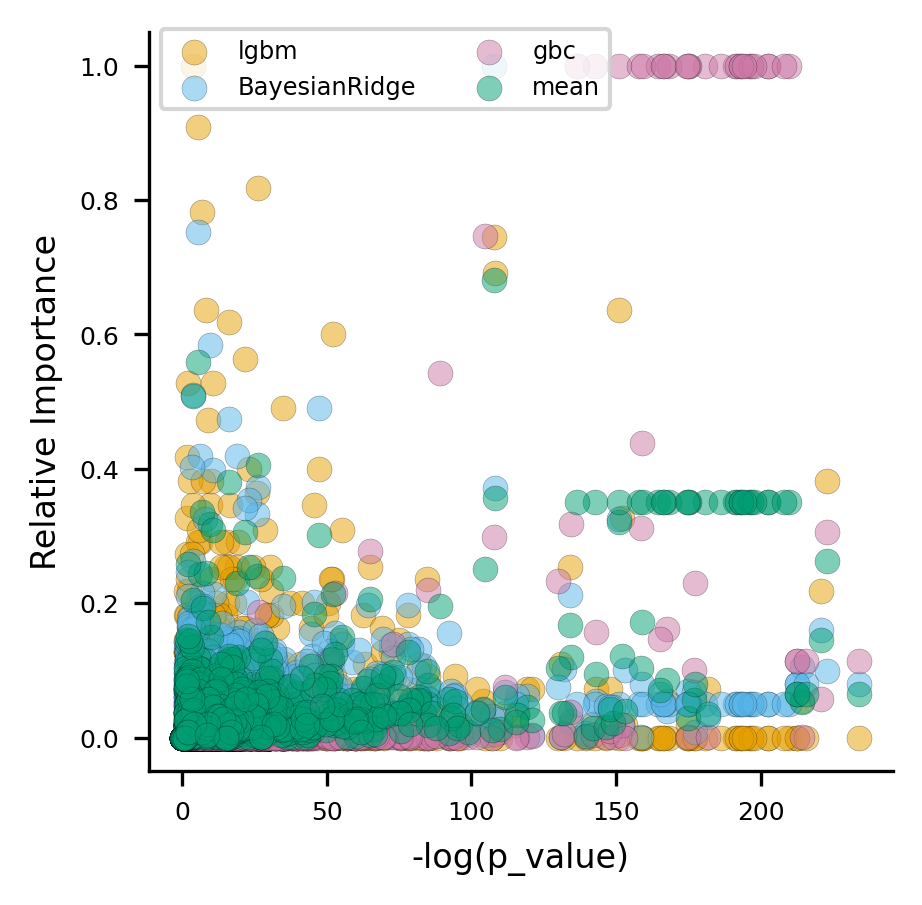

In [28]:
scatter_plot = plot_scatter(summary_result=sr, report_dir=report_dir)

In [29]:
%%time
mean_imp = mean_importance(top, report_dir=report_dir)

CPU times: total: 219 ms
Wall time: 208 ms


mean Done


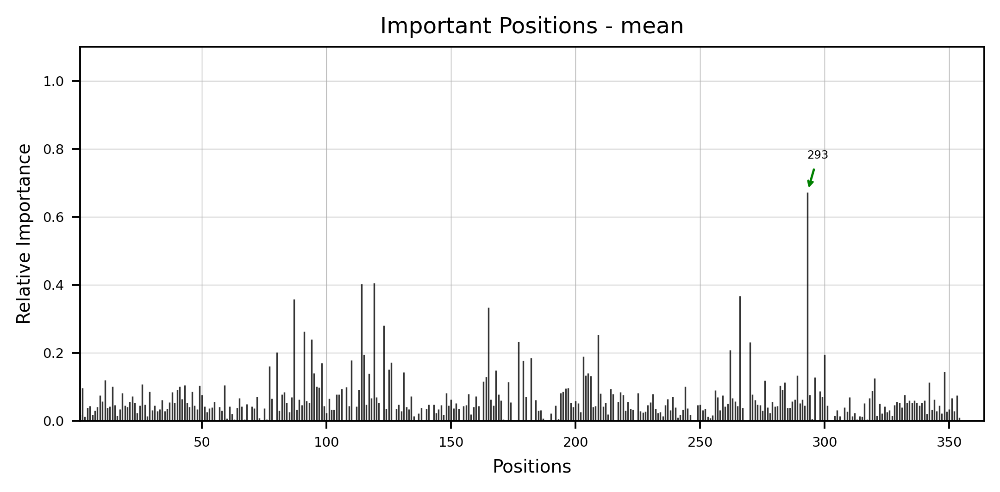

In [30]:
dp_plot(importance=mean_imp,imp_col='mean', model_name='mean', report_dir=report_dir)

In [31]:
tr = prep_pipeline[:4].fit_transform(tr)

lgbm Done
lgbm  Done
BayesianRidge Done
BayesianRidge  Done
gbc Done
gbc  Done


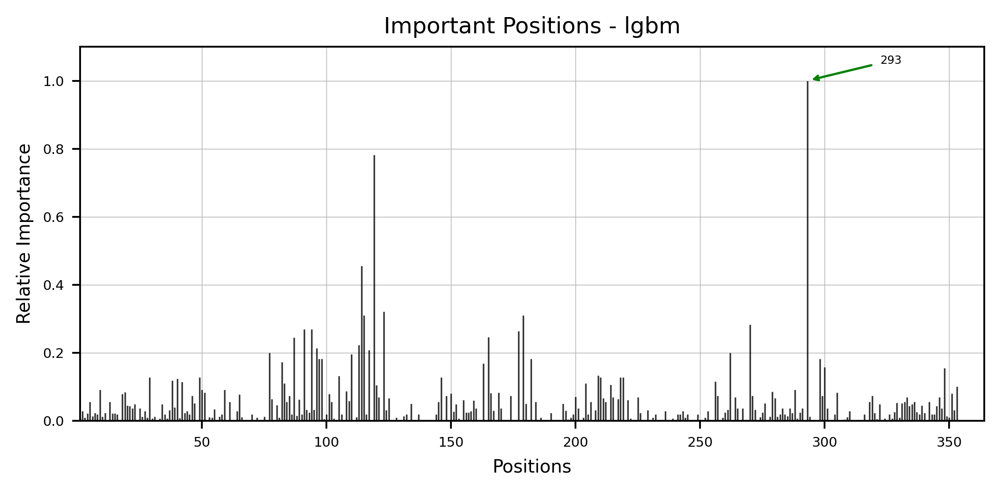

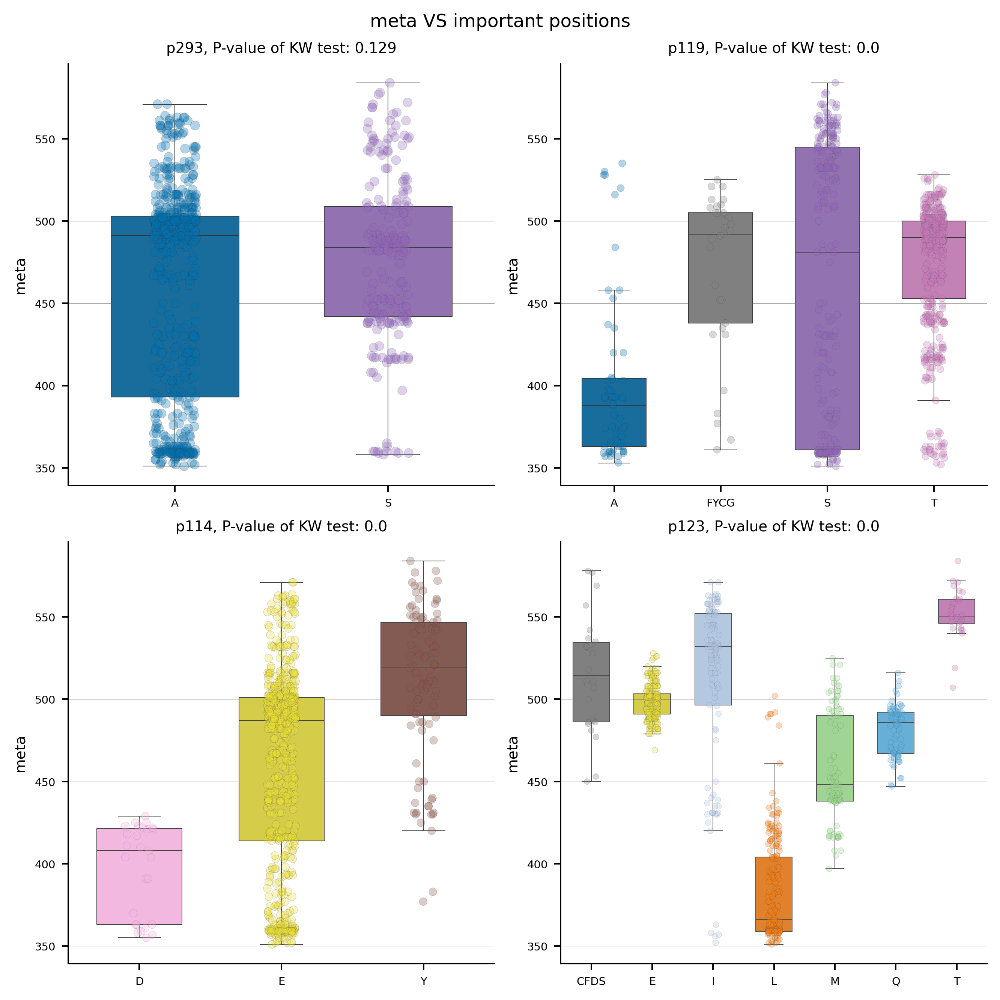

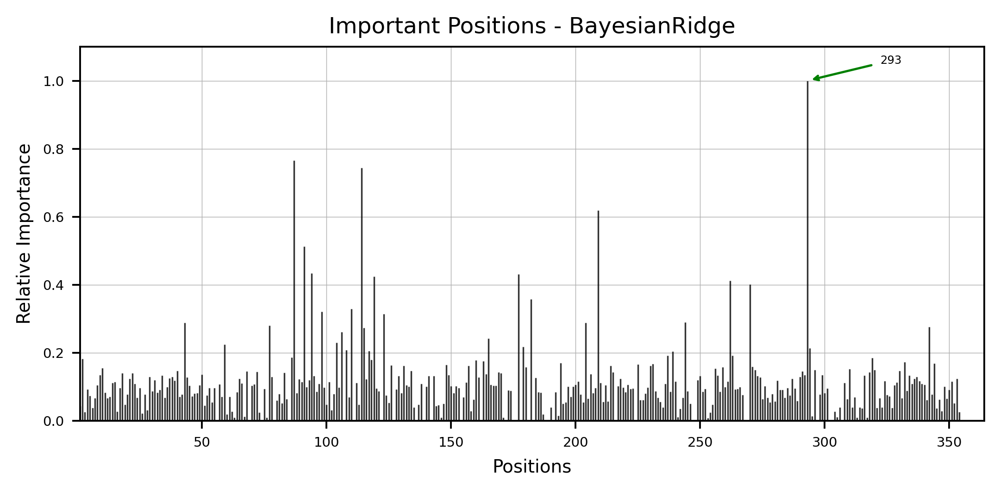

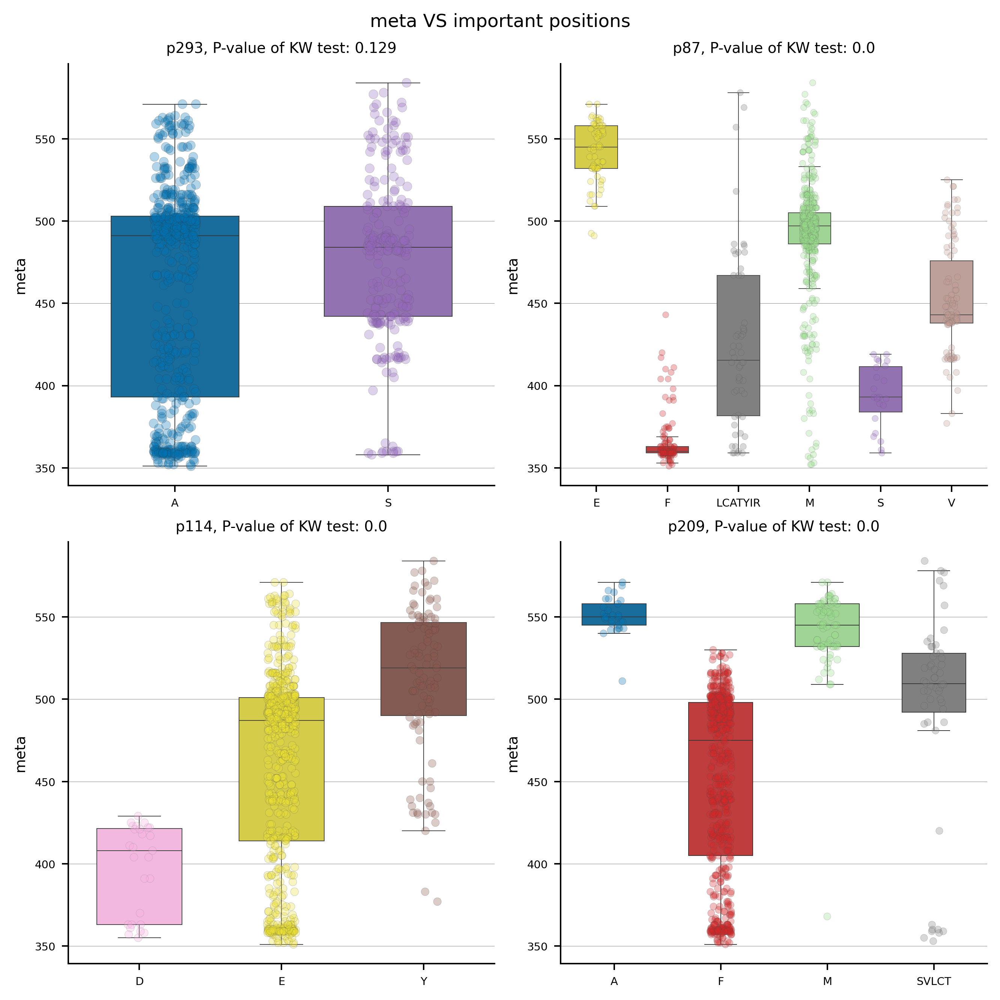

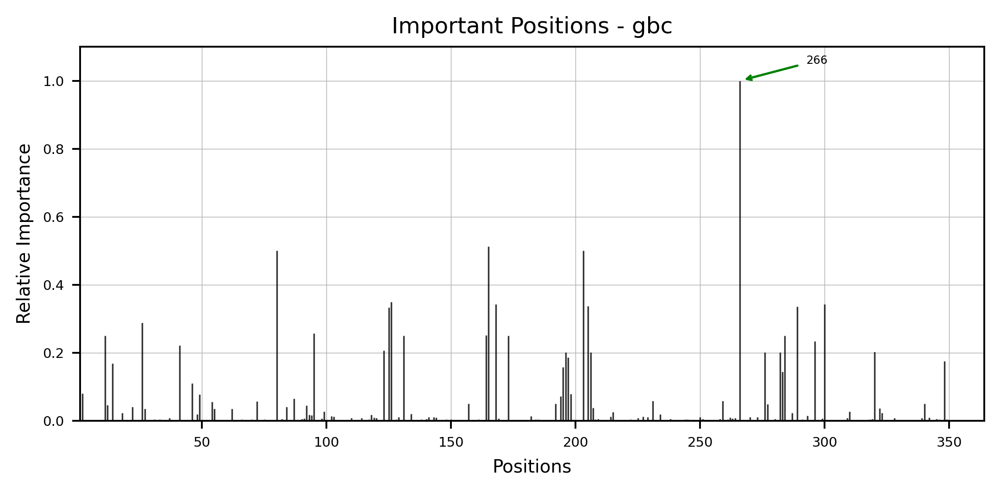

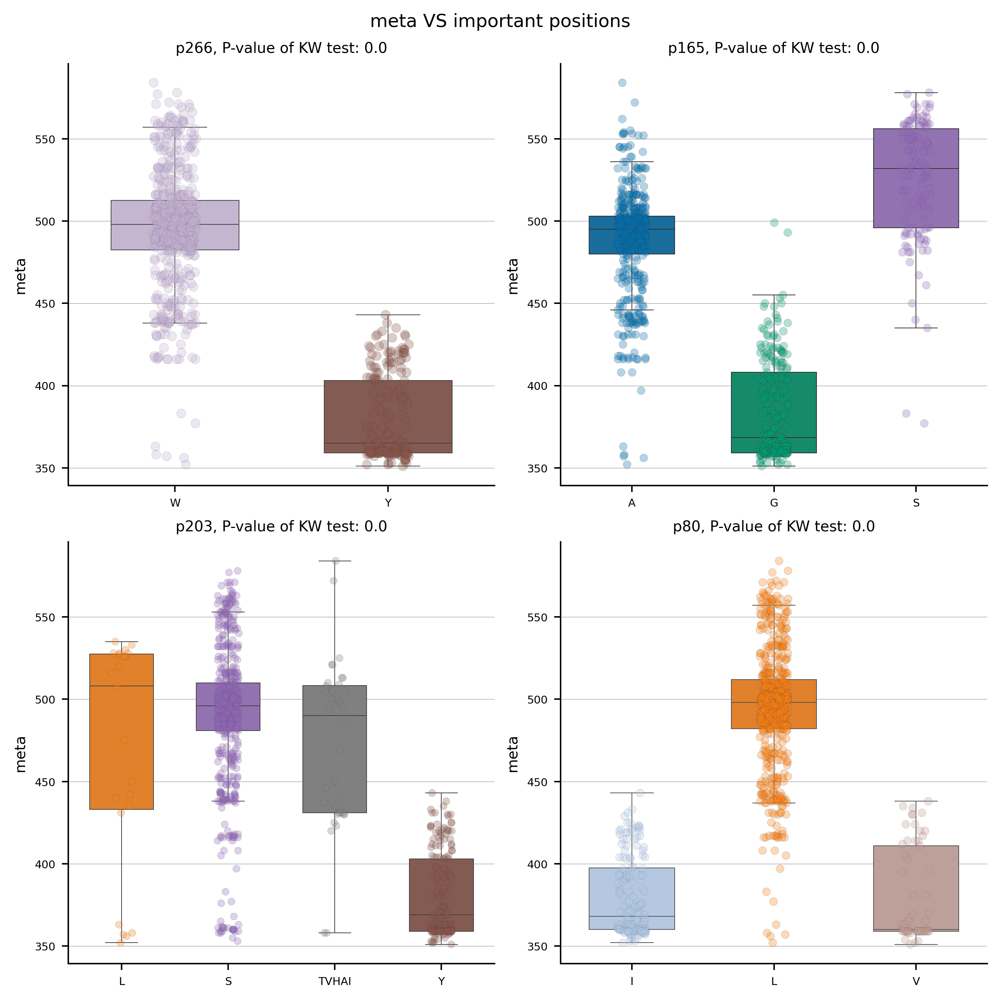

In [32]:
for model in top:
    model_name = model.steps[-1][0]
    dp_plot(importance=importance_from_pipe(model),
            imp_col='standard_value',
            model_name = model_name, report_dir=report_dir)
    
    plot_imp_model(importance=importance_from_pipe(model), 
               X_train=tr, y_train=y, model_name=model_name,
                   meta_var='meta', model_type=ana_type, report_dir=report_dir)

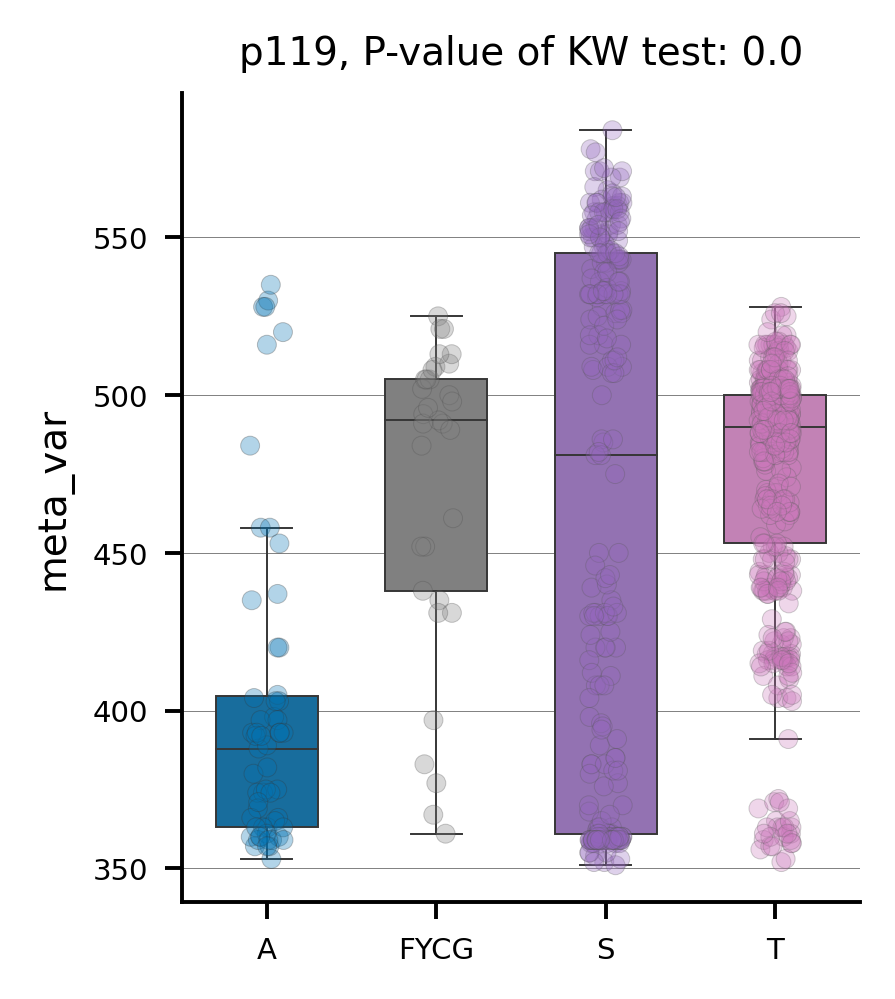

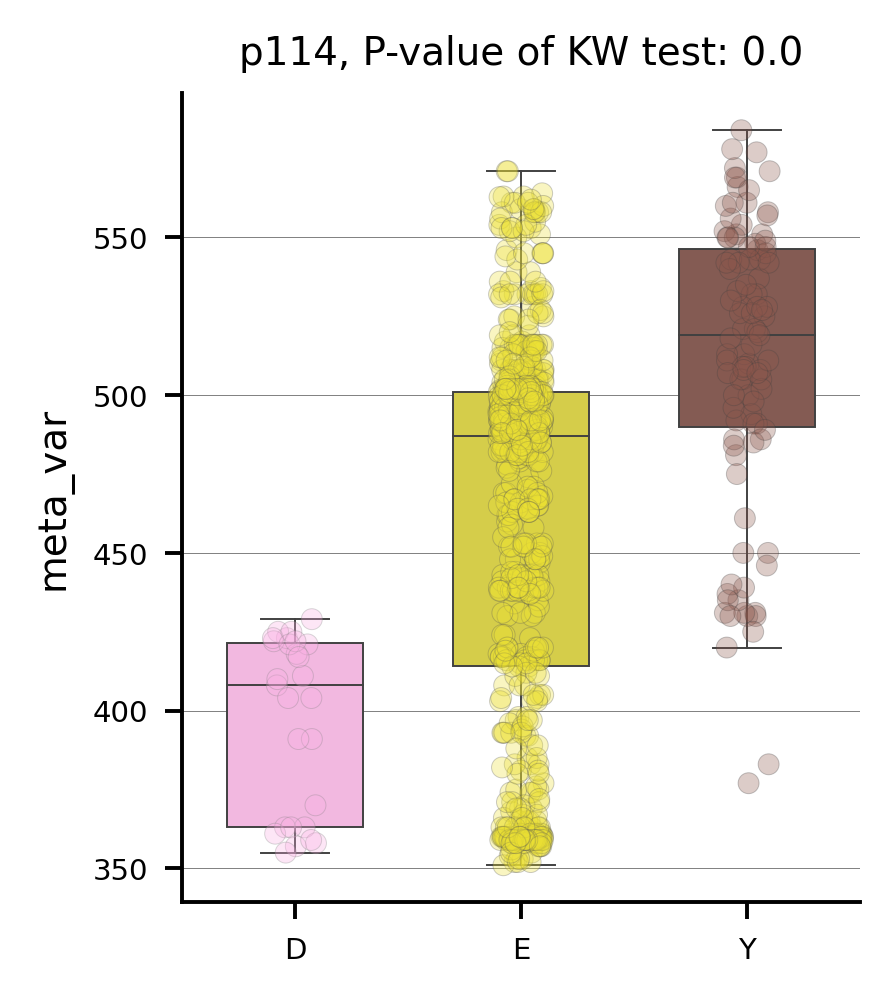

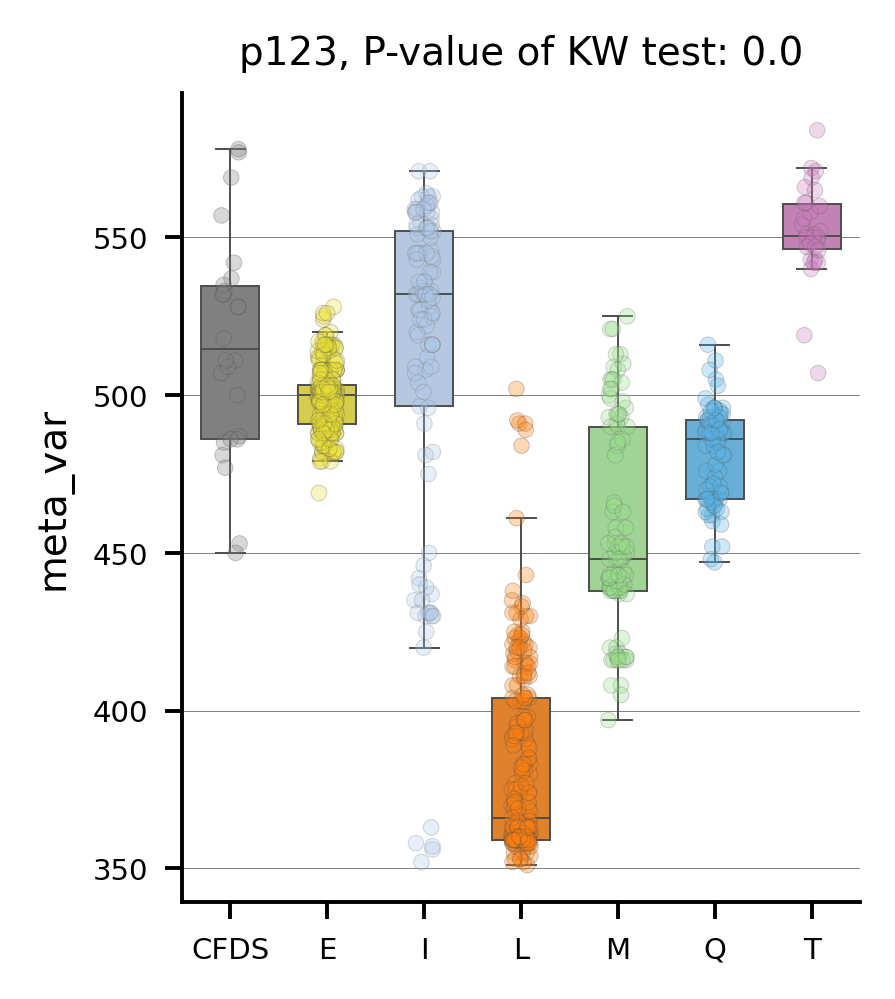

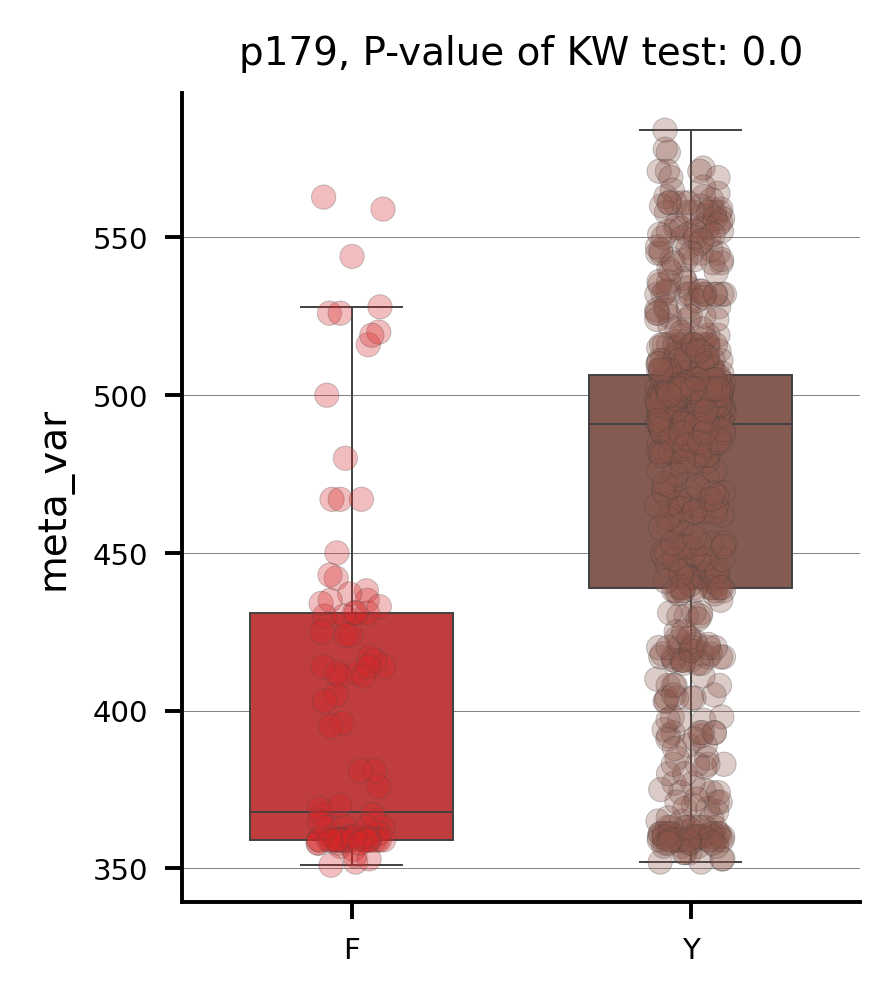

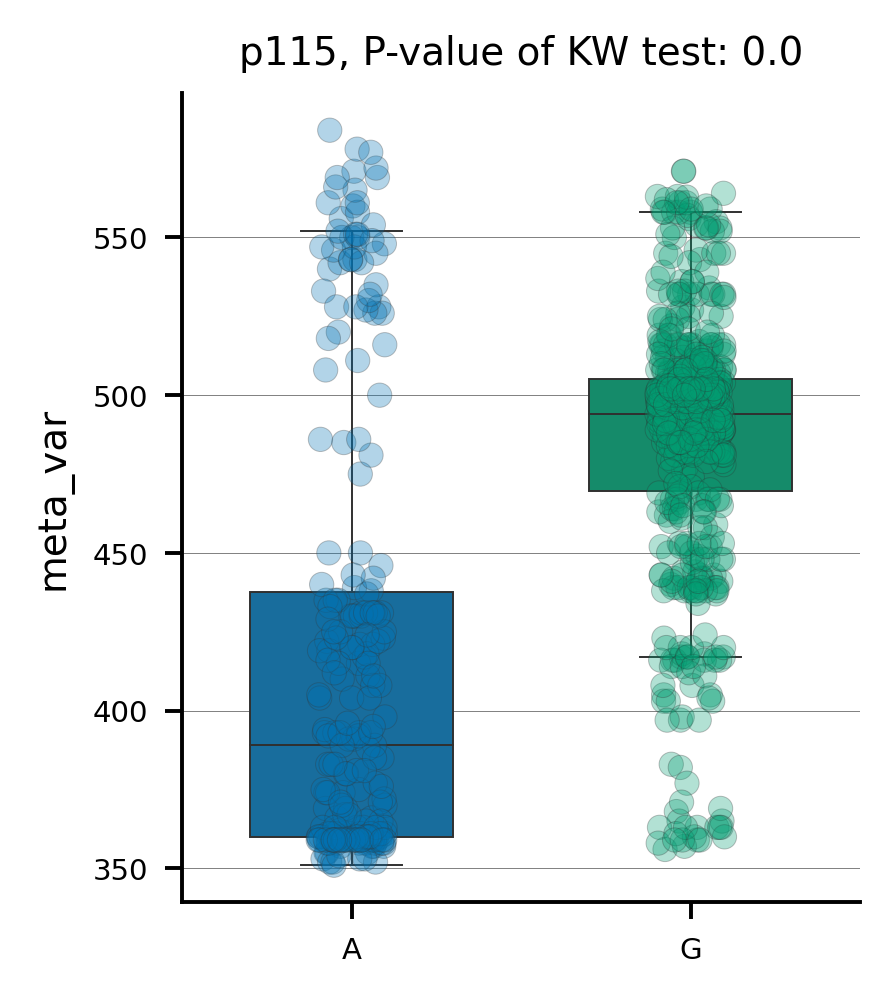

...

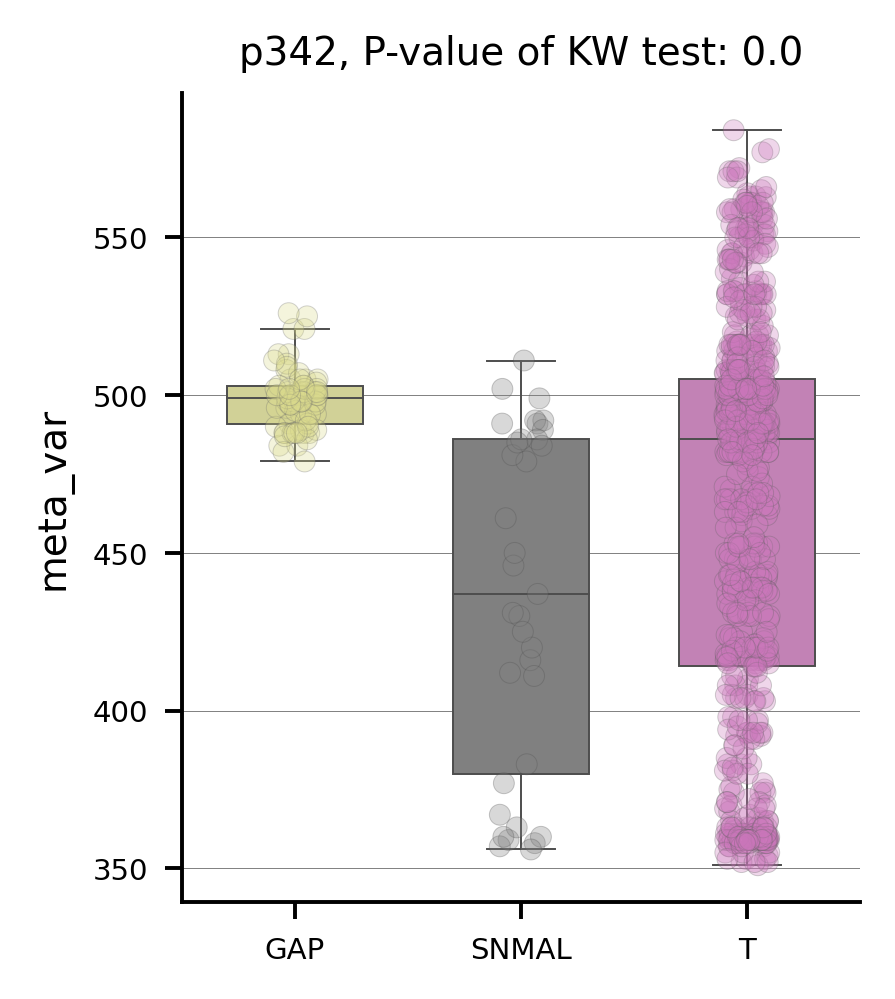

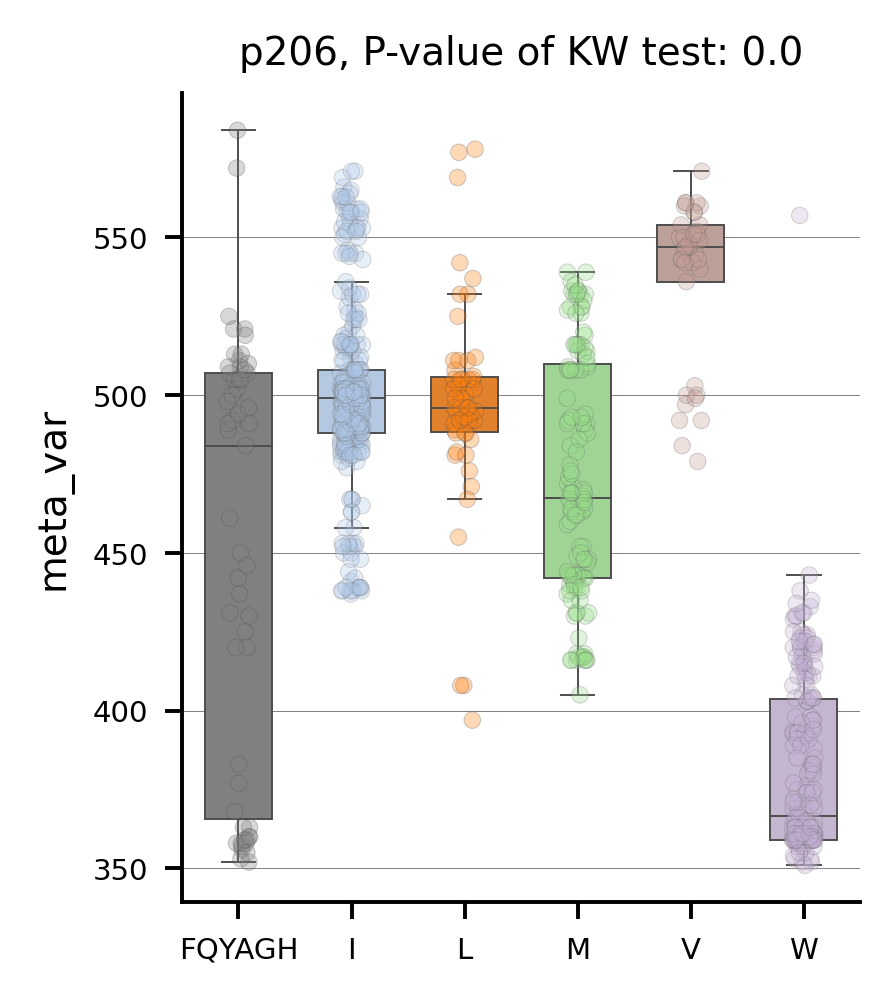

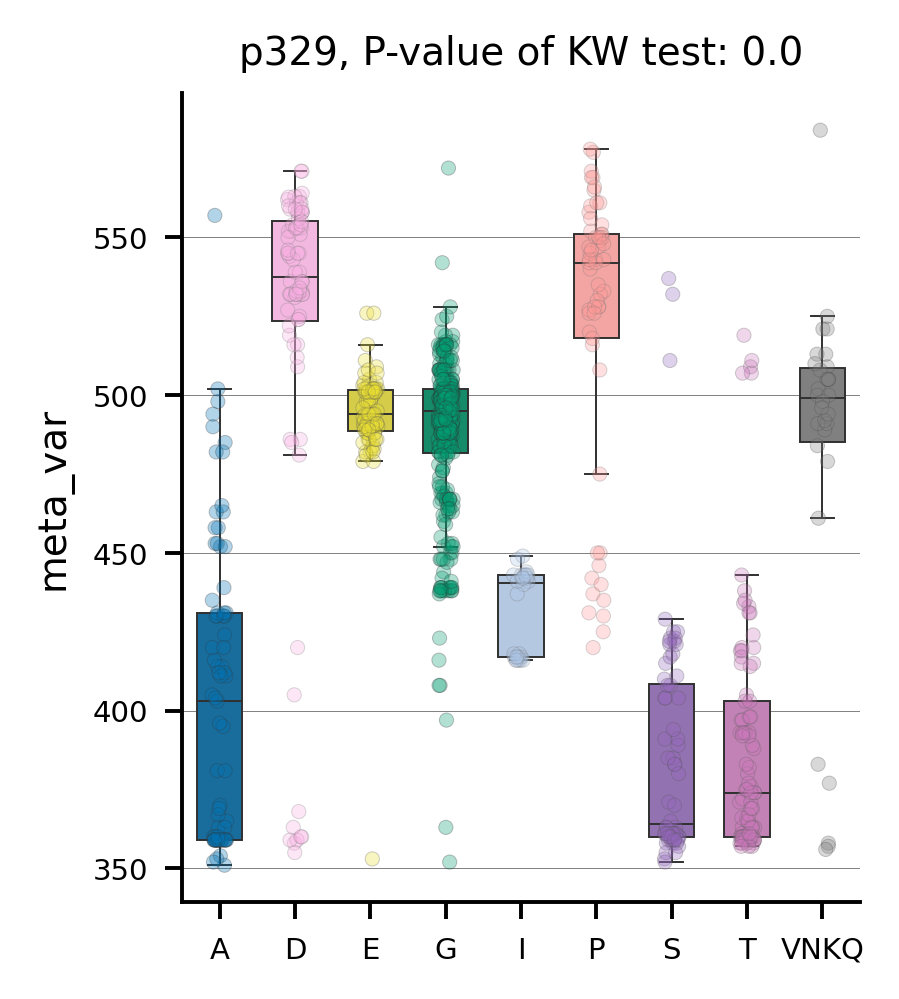

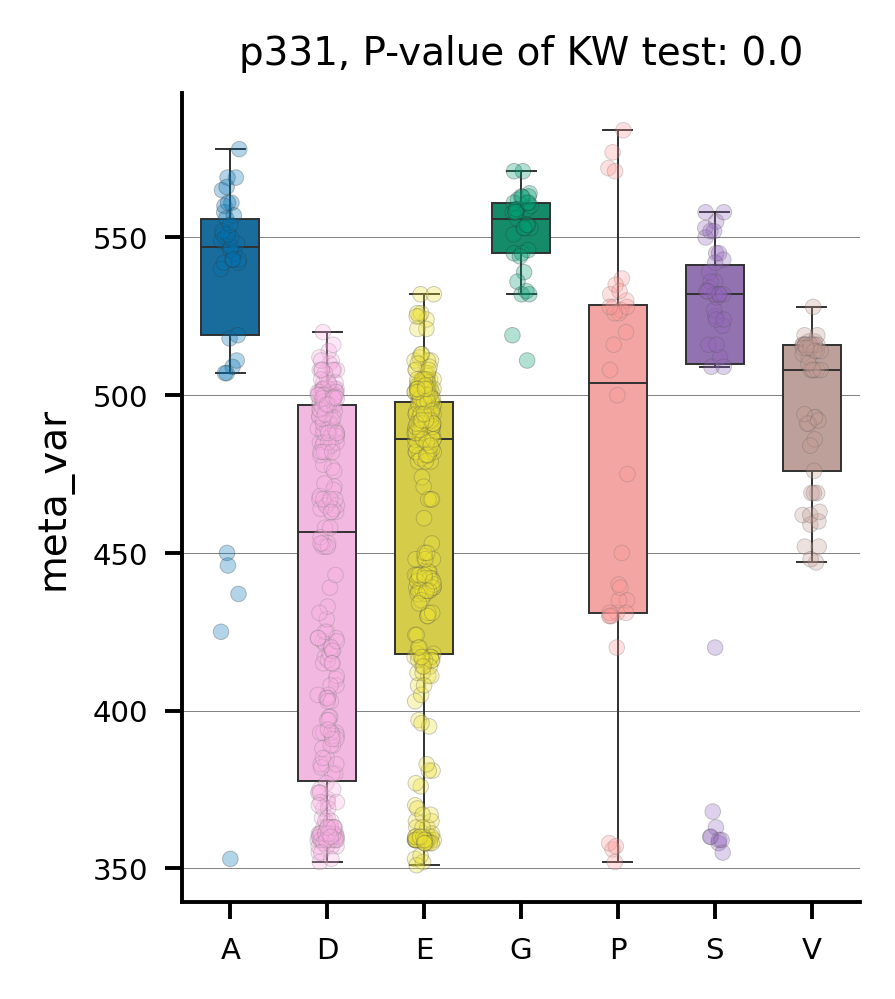

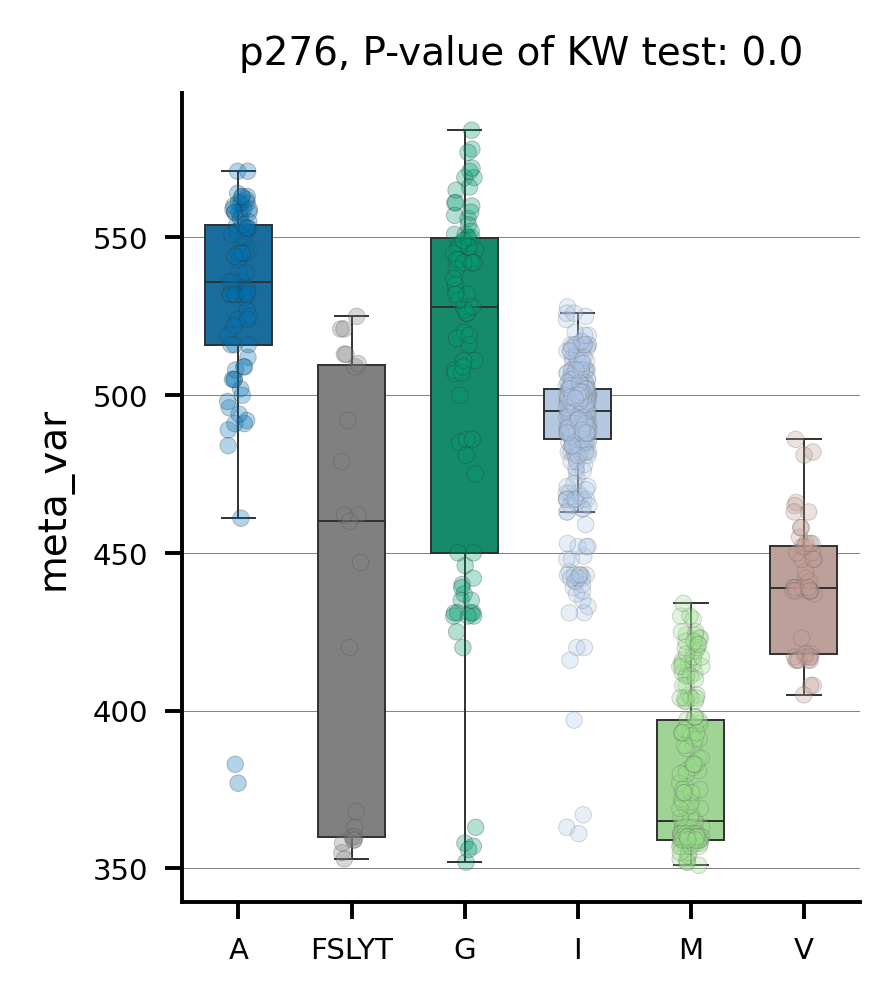

In [33]:
pl = plot_imp_all(final_models=top,
                  X_train=tr, y_train=y,
                  model_type = ana_type,
                  report_dir=report_dir, max_plots=100,
                  figsize=(2.5, 3))

In [34]:
from deepBreaks.utils import load_obj
import joblib
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.metrics import mean_squared_error
load_rf = load_obj(report_dir + '/lgbm.pkl')

In [35]:
predictions = load_rf.predict(unseen)
print(predictions)


[487.12453082 536.68085443 506.17165737 506.93209736 356.22065085
 496.79110932 499.29533452 357.73243569 500.19295017 548.45469935
 423.26757138 532.72174794 442.62477458 423.38680758 515.82653237
 507.04726555 484.6018405  456.92596856 536.52913704 499.02137702
 502.39361105 510.43328248 359.30113769 430.10801274 507.04726555
 515.7931407  487.95040068 460.83610878 494.71269108 483.40633688
 480.92198721 416.95732712 501.82793848 565.70150885 535.74259906
 394.96471354 359.4915888  347.12670488 499.46592776 418.08216609
 360.42728791 564.54093991 555.65179615 372.94175815 484.6018405
 511.67204144 416.55284553 538.02488093 486.70359695 543.87215429]


In [36]:
base_test['Prediction'] = predictions
base_test['Difference'] = base_test['Prediction'] - base_test['Lambda_Max']
base_test = base_test[['Species', 'Opsin_Family', 'Accession','Lambda_Max','Prediction','Difference']]

base_test.to_csv(path_or_buf= f'{report_dir}/basetest_results.csv',index = 'Feature',mode="w")

base_test.head()

,Species,Opsin_Family,Accession,Lambda_Max,Prediction,Difference
S174,"Gekko,Anolis_gekko,carolinensis",Rh2,AH007735.2_1_33-M92035.1_34_64-AH007735.2_65_348,491.0,487.124531,-3.875469
S829,lwsancestor_pigmentd,LWS,lwsancestor_pigmentd_S180A_H197Y,533.0,536.680854,3.680854
S573,Archosaur_sp.,Rh1,AF310191.1_T213I_T217A_V218I,509.0,506.171657,-2.828343
S284,Bos_taurus,Rh1,NM_001014890.2_A269T,514.0,506.932097,-7.067903
S705,Mus_musculus,UVS,NP_031564.1_N149S,359.0,356.220651,-2.779349


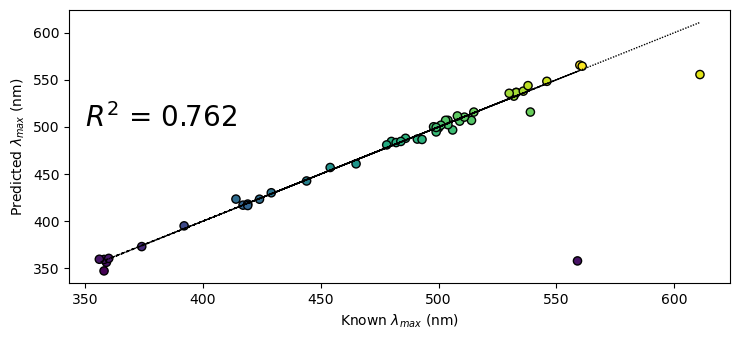

In [37]:
plt.rcParams["figure.autolayout"] = True
plt.rcParams["figure.figsize"] = [7.50, 3.50]

plt.scatter(umd, predictions, c=predictions, ec = 'k', edgecolors='k', s = 35)
plt.plot(umd, umd, c = 'k', linewidth = '1.0', ls = '--', dashes = (1,3))
plt.xlabel('Known $λ_{max}$ (nm)')
plt.ylabel('Predicted $λ_{max}$ (nm)')
plt.annotate(f"$R^2$ = {load_rf.score(unseen, umd):.3f}",(350, 500), fontsize = 20, c = 'k')
plt.rcParams["figure.figsize"] = [7.50, 3.50]


#start, end = plt.get_xlim()
#plt.xaxis.set_ticks(np.arange(start, end, 25))
fileout = f'{report_dir}/50_hetero_dp.pdf'
plt.savefig(fileout)
plt.show()


In [38]:
model_testing__report = f'{report_dir}/model_testing report.tsv'

base_rsq = load_rf.score(unseen, umd)
print(base_rsq)

base_mae = mean_absolute_error(predictions,umd)
print(base_mae)

base_mape = mean_absolute_percentage_error(predictions,umd)
print(base_mape)

base_sqe = mean_squared_error(predictions,umd)
print(base_sqe)

base_rsqe = mean_squared_error(predictions,umd, squared = False)
print(base_rsqe)

with open(model_testing__report , 'w') as f:
    f.write(f'Base Model R^2\tBase Model MAE\tBase Model MAPE\tBase Model SQE\tBase Model RSQE\n')
    f.write(f'{str(base_rsq)}\t{str(base_mae)}\t{str(base_mape)}\t{str(base_sqe)}\t{str(base_rsqe)}')




0.7619017181009022
8.453873671332854
0.02026632733288244
896.6839668494812
29.94468177906523


In [39]:
msp_predictions = load_rf.predict(msp)
print(msp_predictions)

[497.70751537 430.80839509 539.04876844 439.89460986 419.51197073
 484.6018405  522.94660253 417.54803343 382.56401353 432.80274522
 517.54995825 406.51385842 476.19016731 493.79999901 560.47250838
 469.94325911 451.5812284  533.32500959 430.99493599 529.54847848
 467.4704566  414.53705398 532.84826515 534.09785089 431.16921455
 421.73462666 533.5717579  442.49318649 430.45079037 540.43436776
 432.22549486 422.75790494 428.9567685  422.17416274 424.12936645]


In [40]:
meta = "erg_msp_meta.tsv"
msp_meta = pd.read_csv(meta, sep="\t", index_col = False)
msp_meta.head()

,Species,Accession,Lambda_Max
0,Neogonodactylus_oerstedii,KJ127520.1,334
1,Neogonodactylus_oerstedii,KJ127521.1,383
2,Bombus_impatiens,XP_012237087.1,539
3,Bombus_impatiens,XP_003494923.1,424
4,Bombus_impatiens,AAV67326.1,347


In [41]:
lmax_msp = (msp_meta['Lambda_Max'])
lm = []
for i in lmax_msp:
    lm.append(float(i))


In [42]:
columns = ['Species','Accession','Lambda_Max','Predicted','Differnce']
msp_test = pd.DataFrame(index=msp.index, columns = columns)
msp_test['Predicted'] = msp_predictions
msp_test['Species'][0:31] = msp_meta['Species']
msp_test['Accession'][0:31] = msp_meta['Accession']

msp_test.head()

,Species,Accession,Lambda_Max,Predicted,Differnce
Neogonodactylus_oerstedii|334,Neogonodactylus_oerstedii,KJ127520.1,NaN,497.707515,NaN
Neogonodactylus_oerstedii|383,Neogonodactylus_oerstedii,KJ127521.1,NaN,430.808395,NaN
Bombus_impatiens|539,Bombus_impatiens,XP_012237087.1,NaN,539.048768,NaN
Bombus_impatiens|424,Bombus_impatiens,XP_003494923.1,NaN,439.894610,NaN
Bombus_impatiens|347,Bombus_impatiens,AAV67326.1,NaN,419.511971,NaN


In [43]:

msp_test['Lambda_Max'][0:31] = lm
msp_test['Differnce'] = msp_test['Predicted'] - msp_test['Lambda_Max']
msp_test.head()


,Species,Accession,Lambda_Max,Predicted,Differnce
Neogonodactylus_oerstedii|334,Neogonodactylus_oerstedii,KJ127520.1,334.0,497.707515,163.707515
Neogonodactylus_oerstedii|383,Neogonodactylus_oerstedii,KJ127521.1,383.0,430.808395,47.808395
Bombus_impatiens|539,Bombus_impatiens,XP_012237087.1,539.0,539.048768,0.048768
Bombus_impatiens|424,Bombus_impatiens,XP_003494923.1,424.0,439.894610,15.89461
Bombus_impatiens|347,Bombus_impatiens,AAV67326.1,347.0,419.511971,72.511971


In [44]:
msp_test.to_csv(path_or_buf= f'{report_dir}/msp_test_results.csv',index = 'Feature',mode="w")

In [45]:
mae = mean_absolute_error(msp_test['Predicted'][0:31], msp_test['Lambda_Max'][0:31])
print(mae)
msp_rsq = load_rf.score(msp[0:31], msp_test['Lambda_Max'][0:31])
print(msp_rsq)


36.84434725292061
0.47211382536335755


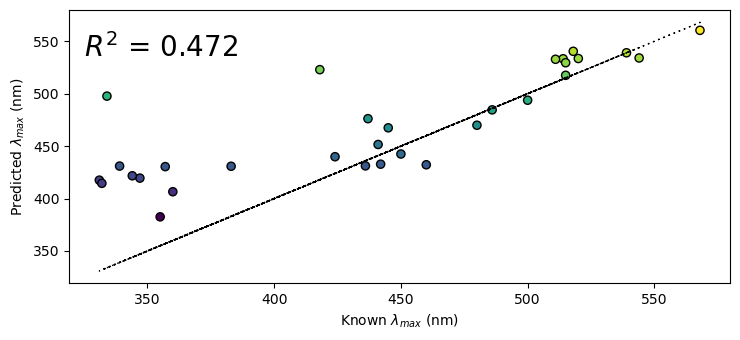

In [46]:
plt.rcParams["figure.autolayout"] = True
plt.rcParams["figure.figsize"] = [7.50, 3.50]

plt.scatter(msp_test['Lambda_Max'][0:31], msp_predictions[0:31], c=msp_predictions[0:31], ec = 'k', edgecolors='k', s = 35)
plt.plot(msp_test['Lambda_Max'][0:31], msp_test['Lambda_Max'][0:31], c = 'k', linewidth = '1.0', ls = '--', dashes = (1,3))
plt.xlabel('Known $λ_{max}$ (nm)')
plt.ylabel('Predicted $λ_{max}$ (nm)')
plt.annotate(f"$R^2$ = {load_rf.score(msp[0:31], msp_test['Lambda_Max'][0:31]):.3f}",(325, 535), fontsize = 20, c = 'k')
plt.rcParams["figure.figsize"] = [7.50, 3.50]


#start, end = plt.get_xlim()
#plt.xaxis.set_ticks(np.arange(start, end, 25))
fileout = f'{report_dir}/31_msp_dp.pdf'
plt.savefig(fileout)
plt.show()

Below is just a way for me to properly format test data for previously trained models using the base training data... 

# importing deepBreaks libraries 
from deepBreaks.utils import get_models, get_scores, get_params, make_pipeline
from deepBreaks.preprocessing import MisCare, ConstantCare, URareCare, CustomOneHotEncoder
from deepBreaks.preprocessing import FeatureSelection, CollinearCare
from deepBreaks.preprocessing import read_data
from deepBreaks.models import model_compare_cv, finalize_top, importance_from_pipe, mean_importance, summarize_results
from deepBreaks.visualization import plot_scatter, dp_plot, plot_imp_model, plot_imp_all
import warnings
import datetime
import os
import numpy as np
import csv
import pandas as pd

# defining user params, file pathes, analysis type

# path to sequences
seqFileName = 'wds_fmt_msp.fasta' 

# path to metadata
metaDataFileName = 'wds_meta.tsv' 

# name of the phenotype
mt = 'Lambda_Max'

# type of the sequences
seq_type = 'aa'

# type of the analysis if it is a classification model, then we put cl instead of reg
ana_type = 'reg' 

# making a unique directory for saving the reports of the analysis
print('direcory preparation')
dt_label = datetime.datetime.now().strftime('%Y-%m-%d_%H-%M-%S')
seqFile = seqFileName.split('.')[0]
report_dir = str(seqFile +'_' + mt + '_' + dt_label)
os.makedirs(report_dir)

print('reading meta-data')
# importing metadata
meta_data = read_data(metaDataFileName, seq_type = None, is_main=False)

# importing sequences data
print('reading fasta file')
tr = read_data(seqFileName, seq_type = seq_type, is_main=True, gap_threshold=0.6)

#start here with removing the bottom ~25 sequences 
msp = tr.iloc[856:].copy()
msp.head()

tr = tr.merge(meta_data.loc[:, mt],  left_index=True, right_index=True)
tr.shape

sample_n = 50
n = 0
while n < 1:
    drop_indices = np.random.choice(tr.index, sample_n, replace=False)
    #print(drop_indices)
    #drop_indices = np.append(drop_indices,['Bovine'])
    #print(drop_indices)
    if 'Bovine' in drop_indices:
        pass
    else:
        n+=1

unseen = tr.loc[drop_indices].copy()
umd = unseen.loc[:, mt].values

unseen.drop(mt, axis=1, inplace=True)
tr = tr.drop(drop_indices)

y = tr.loc[:, mt].values
tr.drop(mt, axis=1, inplace=True)
print('Shape of data is: ', tr.shape)


# <font color=red>STEP 4: Translate Candidate STSs</font> 
## Optional step IF running the classifier model, but could still be useful.
### To find CSTSs, got to the deepBreaks output folder and find the excel sheet 'avg_top_models_feature_importance'
### Sort the top model's feature importance column by 'largest-to-smallest' and take x# of those positions.

In [47]:
import pandas as pd
import os

In [48]:
#STEP 4: Translate Candidate STSs 
#Optional step IF running the classifier model, but could still be useful.
#To find CSTSs, got to the deepBreaks output folder and find the excel sheet 'avg_top_models_feature_importance'
#Sort the top model's feature importance column by 'largest-to-smallest' and take x# of those positions.
m = 0
tm = ''
k=0
gaps=0
#import importance_report.csv from report_dir
true_pos = []
aa = []
tmd = []

df = pd.read_csv(f'{report_dir}\importance_report.csv')

#take the list of important sites and translate them to the bovine standard equivalent, we do this by taking the site number and subtracting the number of '-' between the start of the sequence and the desired site. 
for rows in bovine.values:  
    rows = str(rows)
    print(rows)
    if rows == 'nan':
    #We want to write the 'true_pos', 'aa', and 'TMD' to the 'importance_report' csv file
        gaps += 1
        k += 1
        true_pos.append('NA')
        aa.append('-')
        tmd.append('NA')
    else:
        #print("The number of gaps is " + str(gaps))
        k+=1
        trans_site = k - gaps

        if trans_site in range(39,66):
            tm = '1'
        elif trans_site in range(3,38):
            tm = 'N-Termina'
        elif trans_site in range(72,100):
            tm = '2'
        elif trans_site in range(110,141):
            tm = '3'
        elif trans_site in range(151,174):
            tm = '4'
        elif trans_site in range(200,231):
            tm = '5'
        elif trans_site in range(245,276):
            tm = '6'
        elif trans_site in range(285,311):
            tm = '7'
        else:
            tm = 'NA'
        
        true_pos.append(str(trans_site))
        aa.append(rows)
        tmd.append(tm)
true_pos.pop()
aa.pop()
tmd.pop()

df['true_position'] = true_pos
df['TMD'] = tmd
df['amino_acid'] = aa

df.to_csv(path_or_buf= os.path.join(report_dir,r'importance_report.csv'),index = 'Feature',mode="w")
df.head()


M
N
G
T
E
G
P
N
F
Y
V
P
F
nan
S
N
K
T
G
V
V
R
S
P
F
E
A
P
Q
Y
Y
L
A
E
P
W
Q
F
S
M
L
A
A
Y
M
F
L
L
I
M
L
G
F
P
I
N
F
L
T
L
Y
V
T
V
Q
H
K
K
L
R
T
P
L
N
Y
I
L
L
N
L
A
V
A
D
L
F
M
V
F
G
G
F
T
T
T
L
Y
T
S
L
H
G
Y
F
V
F
G
P
T
G
C
N
L
E
G
F
F
A
T
L
G
G
E
I
A
L
W
S
L
V
V
L
A
I
E
R
Y
V
V
V
C
K
P
M
S
N
F
R
F
G
E
N
H
A
I
M
G
V
A
F
T
W
V
M
A
L
A
C
A
A
P
P
L
V
G
W
S
R
Y
I
P
E
G
M
Q
C
S
C
G
I
D
Y
Y
T
P
H
E
E
T
N
N
E
S
F
V
I
Y
M
F
V
V
H
F
I
I
P
L
I
V
I
F
F
C
Y
G
Q
L
V
F
T
V
K
E
A
A
A
Q
Q
Q
E
S
A
T
T
Q
K
A
E
K
E
V
T
R
M
V
I
I
M
V
I
A
F
L
I
C
W
L
P
Y
A
G
V
A
F
Y
I
F
T
H
Q
G
S
D
F
G
P
I
F
M
T
I
P
A
F
F
A
K
T
S
A
V
Y
N
P
V
I
Y
I
M
M
N
K
Q
F
R
N
C
M
V
T
T
L
C
C
G
K
P
L
G
nan
D
D
E
nan
A
S
T
T
V
S
K
T
E
nan
nan
nan
nan
nan
T
S
Q
V
A
P
A


,feature,lgbm,BayesianRidge,gbc,mean,true_position,TMD,amino_acid
0,1,0.009091,0.042879,0.000209,0.017393,1,NA,M
1,2,0.027273,0.182237,0.080123,0.096544,2,NA,N
2,3,0.009091,0.024641,0.000155,0.011296,3,N-Termina,G
3,4,0.020779,0.092470,0.000579,0.037943,4,N-Termina,T
4,5,0.054545,0.072688,0.000308,0.042514,5,N-Termina,E
